# Dataset inspection

Due to limited resources, we opted to use just a portion of the datasets in question.
The criteria upon which a file is included or not are derived from the following analysis.

For each file in the dataset, following our preprocessing pipeline, we produce some basic statistics for each document:

- number of sections (`int`);
- number sentences per section (`List[int]`);
- number of tokens per sentence (`List[List[int]]`);
- number sentences (summary) (`int`);
- number of tokens per sentence (summary) (`List[int]`).

They are generated separately from this notebook and saved to a file.

In [2]:
import json

with open('documents.stats', 'r') as fp:
    statistics = json.load(fp)
    
with open('val.stats', 'r') as fp:
    stats_val = json.load(fp)

In [3]:
print(statistics[list(statistics.keys())[0]])

{'body': [[[24, 24, 12], [48, 48, 29], [22, 22, 11]], [[20, 20, 11], [18, 18, 11], [33, 33, 16], [26, 25, 14], [19, 19, 11], [38, 38, 19], [40, 40, 24], [21, 21, 11], [30, 30, 16], [35, 35, 20], [22, 22, 13], [38, 37, 22], [49, 49, 29], [37, 36, 19], [26, 26, 15], [17, 17, 10], [22, 21, 12], [36, 35, 21], [21, 20, 12], [51, 50, 31], [34, 34, 17], [23, 23, 12], [52, 51, 26], [40, 40, 24], [28, 28, 15], [27, 27, 17], [17, 17, 11]], [[21, 21, 9], [16, 16, 8], [24, 24, 12], [21, 21, 14], [48, 47, 27], [47, 47, 30], [41, 36, 23], [21, 21, 11], [22, 22, 14], [21, 20, 12], [44, 43, 27], [16, 16, 8], [20, 20, 10], [56, 55, 29], [17, 17, 11], [44, 43, 23], [42, 42, 23], [28, 28, 19]], [[23, 22, 11], [22, 22, 10], [31, 27, 13], [17, 16, 9], [37, 36, 19], [44, 43, 24], [35, 35, 17]], [[42, 42, 25]], [[17, 16, 8], [19, 18, 12]], [[29, 29, 16], [38, 38, 19], [44, 44, 21], [19, 18, 10], [31, 30, 18]]], 'summary': [[17, 16, 8], [31, 30, 13], [14, 12, 6], [17, 16, 8], [34, 33, 15], [28, 27, 15], [42, 

## Preliminaries

First we enrich the statistics by aggrageting multi-valued fields, thus creating the fields total number of sentences (`int`) and total number of tokens (`int`). We then produce some section and sentence level statistics which will come useful later.

In [4]:
def aggregate(statistics, kind):
    keys = {'all': 0, 'representable': 1, 'graphable': 2}
    output = {key: _aggregate(vals, keys[kind]) for key, vals in statistics.items()}
    return output
    
def _aggregate(vals, kind):
    output = {}
    body = [[sentence[kind] for sentence in section] for section in vals['body']]
    summary = [sentence[kind] for sentence in vals['summary']]
    output['number_of_sections'] = len(body)
    output['number_of_sentences_section'] = [len(section) for section in body]
    output['length_sentences_section'] = body
    output['number_of_sentences_summary'] = len(summary)
    output['length_sentences_summary'] = summary
    output['tot_sentences'] = sum(output['number_of_sentences_section'])
    output['tokens_section'] = [sum(section) for section in output['length_sentences_section']]
    output['tot_tokens'] = sum(output['tokens_section'])
    output['tot_tokens_summary'] = sum(output['length_sentences_summary'])
    return output

all_statistics = aggregate(statistics, 'all')
all_stats_val = aggregate(stats_val, 'all')

rep_statistics = aggregate(statistics, 'representable')
rep_stats_val = aggregate(stats_val, 'representable')

gra_statistics = aggregate(statistics, 'graphable')
gra_stats_val = aggregate(stats_val, 'graphable')

In [5]:
file = list(statistics.keys())[0]
print(file)
print()
print(all_statistics[file])
print()
print(rep_statistics[file])
print()
print(gra_statistics[file])

C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC101227.txt

{'number_of_sections': 7, 'number_of_sentences_section': [3, 27, 18, 7, 1, 2, 5], 'length_sentences_section': [[24, 48, 22], [20, 18, 33, 26, 19, 38, 40, 21, 30, 35, 22, 38, 49, 37, 26, 17, 22, 36, 21, 51, 34, 23, 52, 40, 28, 27, 17], [21, 16, 24, 21, 48, 47, 41, 21, 22, 21, 44, 16, 20, 56, 17, 44, 42, 28], [23, 22, 31, 17, 37, 44, 35], [42], [17, 19], [29, 38, 44, 19, 31]], 'number_of_sentences_summary': 10, 'length_sentences_summary': [17, 31, 14, 17, 34, 28, 42, 22, 45, 33], 'tot_sentences': 63, 'tokens_section': [94, 820, 549, 209, 42, 36, 161], 'tot_tokens': 1911, 'tot_tokens_summary': 283}

{'number_of_sections': 7, 'number_of_sentences_section': [3, 27, 18, 7, 1, 2, 5], 'length_sentences_section': [[24, 48, 22], [20, 18, 33, 25, 19, 38, 40, 21, 30, 35, 22, 37, 49, 36, 26, 17, 21, 35, 20, 50, 34, 23, 51, 40, 28, 27, 17], [21, 16, 24, 21, 47, 47, 36, 21, 22, 20, 43, 16, 20, 55, 17, 43, 42, 28],

## Ill-formed documents

The first kind of selection we propose is in terms of the relation between the target summary and the document. In particular we exclude those for which the summary is lengthier than the body either in terms of sentences or in terms of number of tokens.

In this first filtering we also exclude documents for which either the summary or the body have no sentences or tokens.

In [6]:
from collections import defaultdict

def pre_filter(all_stats, rep_stats, gra_stats):
    retain = defaultdict(lambda: True)
    for stats in [all_stats, rep_stats, gra_stats]:
        for f, d in stats.items():
            if d['tot_sentences'] < d['number_of_sentences_summary'] or\
                d['tot_tokens'] < d['tot_tokens_summary'] or\
                d['tot_sentences'] == 0 or d['tot_tokens'] == 0 or\
                d['number_of_sentences_summary'] == 0 or d['tot_tokens_summary'] == 0:
                retain[f] = False
    return retain

def filter_stats(stats, retain):
    return {key: vals for key, vals in stats.items() if retain[key]}

old_len, old_len_val = len(statistics), len(stats_val)

retain = pre_filter(all_statistics, rep_statistics, gra_statistics)
ret_val = pre_filter(all_stats_val, rep_stats_val, gra_stats_val)

all_statistics = filter_stats(all_statistics, retain)
rep_statistics = filter_stats(rep_statistics, retain)
gra_statistics = filter_stats(gra_statistics, retain)

all_stats_val = filter_stats(all_stats_val, retain)
rep_stats_val = filter_stats(rep_stats_val, retain)
gra_stats_val = filter_stats(gra_stats_val, retain)

new_len, new_len_val = len(all_statistics), len(all_stats_val)

def print_retained(new_len, old_len):
    percentage = new_len/old_len*100
    print(f"Retained {percentage:.2f} % of files ({new_len}/{old_len})")
    
print('Training')
print_retained(new_len, old_len)
print('Validation')
print_retained(new_len_val, old_len_val)

Training
Retained 96.49 % of files (115713/119924)
Validation
Retained 100.00 % of files (6633/6633)


## Document

### Number of sections

Then, the first criteria with which we will filter the files is the number of sections: we identify the *knee* and *elbow* in the distribution across documents, and select the corresponding values as lower and upper bounds (possibly with a bit of leeway).

The process is analogous for other measures.

In [7]:
n_sections = [d['number_of_sections'] for d in all_statistics.values()]

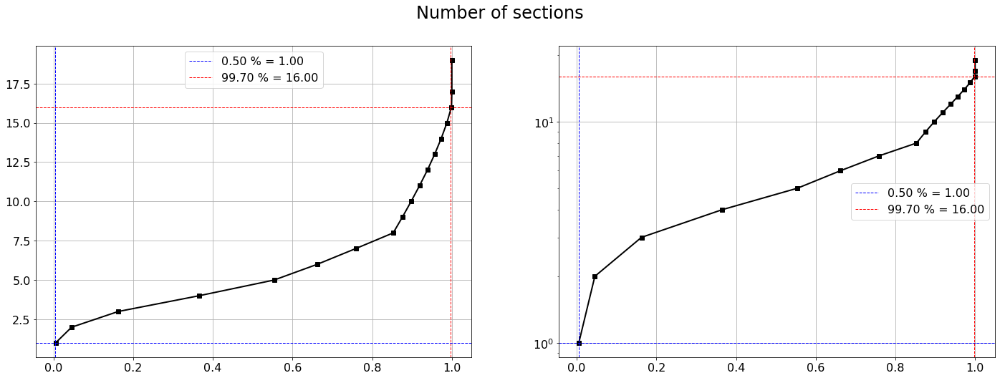

In [8]:
from typing import Iterable, Optional
import numpy as np
import matplotlib.pyplot as plt

SMALL_SIZE = 16
MEDIUM_SIZE = 20
BIGGER_SIZE = 24

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

FIGSIZE = WIDTH, HEIGHT = 12, 8

def plot_line(stats: np.ndarray, qs: Iterable[float], title: str):
    fig, axs = plt.subplots(figsize=(2*WIDTH, HEIGHT), ncols=2)
    ys, xs = np.unique(stats, return_counts=True)
    xs = np.cumsum(xs)
    xs = xs / xs[-1]
    vs = np.quantile(stats, qs)
    if xs.size < 20:
        axs[0].plot(xs, ys, linewidth=2, color='black', marker='s')
        axs[1].plot(xs, ys, linewidth=2, color='black', marker='s')
    else:
        axs[0].plot(xs, ys, linewidth=2, color='black')
        axs[1].plot(xs, ys, linewidth=2, color='black')
    kwargs = {'linewidth': 1, 'linestyle': '--'}
    for q, v in zip(qs, vs):
        if q > .5:
            kwargs['color'] = 'red'
        else:
            kwargs['color'] = 'blue'
        axs[0].axhline(v, **kwargs)
        axs[1].axhline(v, **kwargs)
        axs[0].axvline(q, **kwargs)
        axs[1].axvline(q, **kwargs)
        axs[0].plot([], [], label=f'{q*100:.2f} % = {v:.2f}', **kwargs)
        axs[1].plot([], [], label=f'{q*100:.2f} % = {v:.2f}', **kwargs)
    axs[1].set_yscale('log')
    axs[0].legend()
    axs[1].legend()
    axs[0].grid()
    axs[1].grid()
    fig.suptitle(title)
    plt.show()

plot_line(np.array(n_sections), [.005, .997], 'Number of sections')

In [9]:
from typing import Dict, Any

MIN_SECTIONS, MAX_SECTIONS = 2, 16

def n_sections_criteria(all_stats: Dict[str, Any], *args) -> bool:
    return MIN_SECTIONS <= all_stats['number_of_sections'] <= MAX_SECTIONS

### Number of sentences

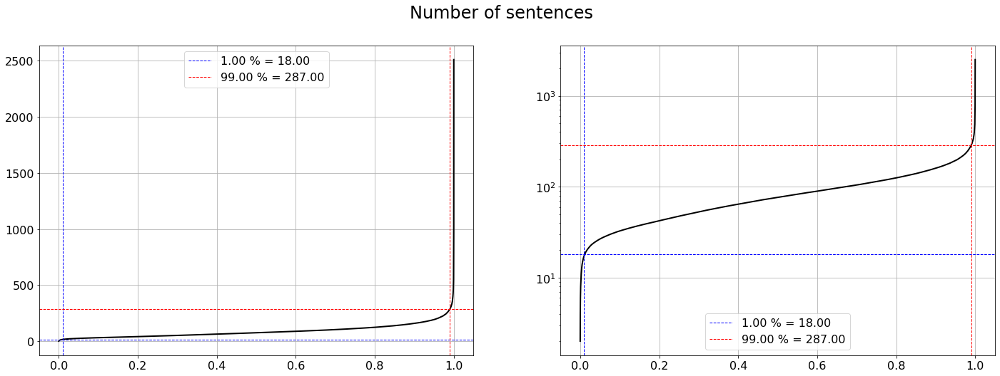

In [10]:
n_sentences = [sum(d['number_of_sentences_section']) for d in all_statistics.values()]
plot_line(np.array(n_sentences), [.01, .99], 'Number of sentences')

In [11]:
MIN_SENTENCES, MAX_SENTENCES = 16, 300

def n_sentences_criteria(all_stats: Dict[str, Any], *args) -> bool:
    return MIN_SENTENCES <= sum(all_stats['number_of_sentences_section']) <= MAX_SENTENCES

### Number of tokens

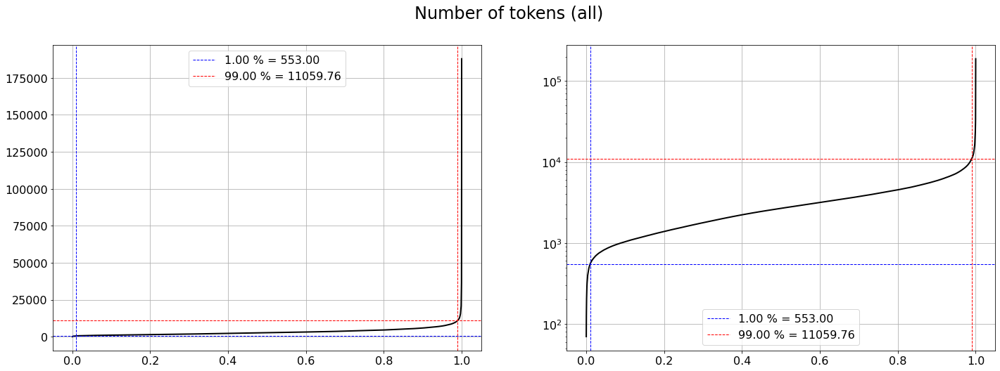

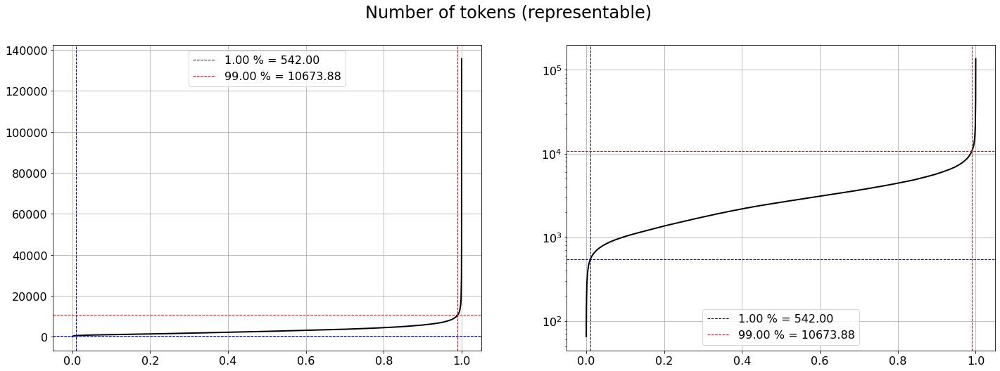

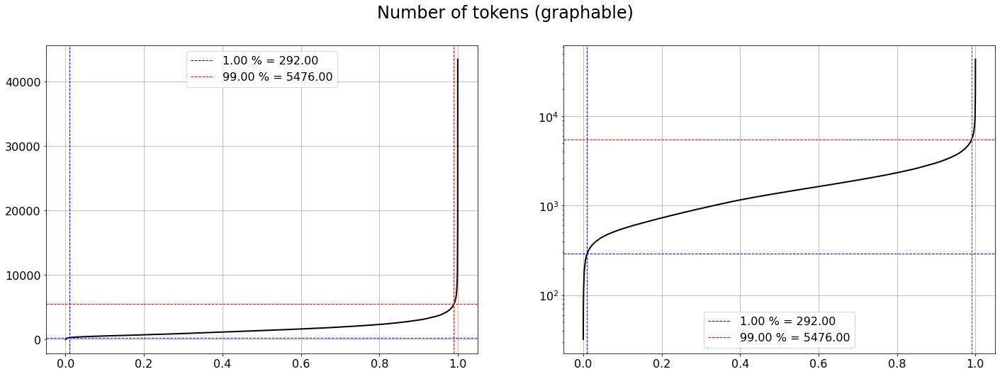

In [12]:
def get_n_tokens(statistics):
    return [sum([vals for section in d['length_sentences_section'] for vals in section])
               for d in statistics.values()]

all_tokens = get_n_tokens(all_statistics)
rep_tokens = get_n_tokens(rep_statistics)
gra_tokens = get_n_tokens(gra_statistics)

plot_line(np.array(all_tokens), [.01, .99], 'Number of tokens (all)')
plot_line(np.array(rep_tokens), [.01, .99], 'Number of tokens (representable)')
plot_line(np.array(gra_tokens), [.01, .99], 'Number of tokens (graphable)')

In [13]:
MIN_ALL_TOKENS, MAX_ALL_TOKENS = 500, 12_000
MIN_REP_TOKENS, MAX_REP_TOKENS = 500, 12_000
MIN_GRA_TOKENS, MAX_GRA_TOKENS = 250, 6_000

def n_tokens_criteria(all_stats: Dict[str, Any], rep_stats: Dict[str, Any], gra_stats: Dict[str, Any]) -> bool:
    all_vals = [n_tokens for by_section in all_stats['length_sentences_section'] for n_tokens in by_section]
    rep_vals = [n_tokens for by_section in rep_stats['length_sentences_section'] for n_tokens in by_section]
    gra_vals = [n_tokens for by_section in gra_stats['length_sentences_section'] for n_tokens in by_section]
    return all([
        MIN_ALL_TOKENS <= sum(all_vals) <= MAX_ALL_TOKENS,
        MIN_REP_TOKENS <= sum(rep_vals) <= MAX_REP_TOKENS,
        MIN_GRA_TOKENS <= sum(gra_vals) <= MAX_GRA_TOKENS
    ])

## Section

We then inspect statistics of sections in order to filter documents presenting abnormal sections. The process is very similar to that used at document level and considers number of tokens and of sentences.

In [14]:
def get_section_statistics(statistics):
    section_statistics = defaultdict(lambda: list())
    for f, d in statistics.items():
        section_statistics['n_sentences'] += d['number_of_sentences_section']
        section_statistics['n_tokens'] += [sum(vals) for vals in d['length_sentences_section']]
    return section_statistics

section_all_statistics = get_section_statistics(all_statistics)
section_rep_statistics = get_section_statistics(rep_statistics)
section_gra_statistics = get_section_statistics(gra_statistics)

### Number of sentences

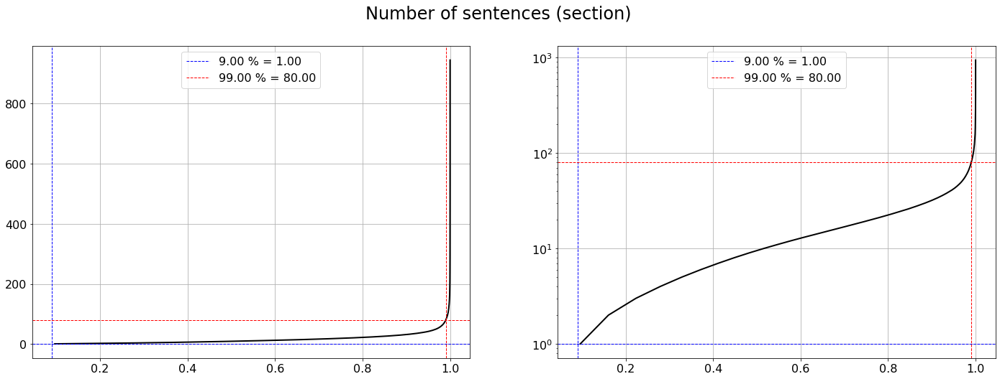

In [15]:
plot_line(section_all_statistics['n_sentences'], [.09, .99], 'Number of sentences (section)')

In [16]:
MIN_SENTENCES_SECTION, MAX_SENTENCES_SECTION = 1, 80

def n_sentences_section_criteria(stats: Dict[str, Any], *args) -> bool:
    return all([MIN_SENTENCES_SECTION <= val <= MAX_SENTENCES_SECTION
               for val in stats['number_of_sentences_section']])

### Number of tokens

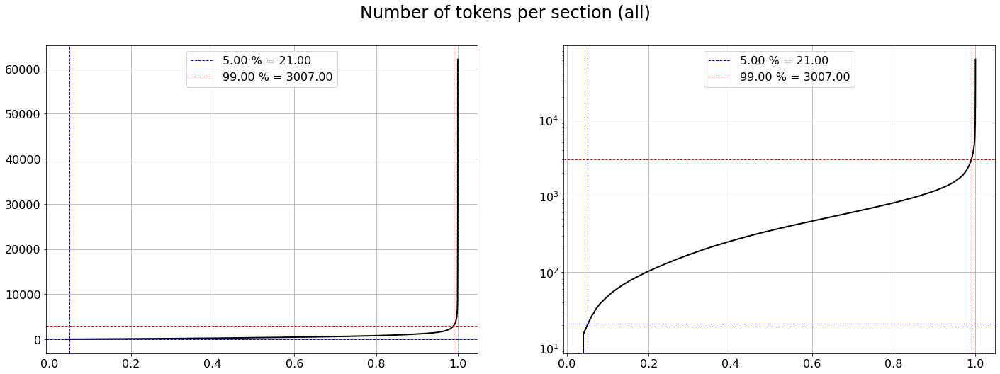

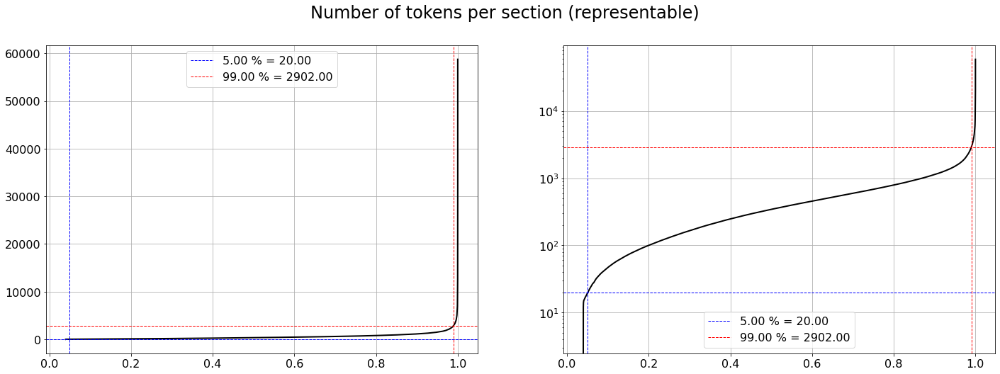

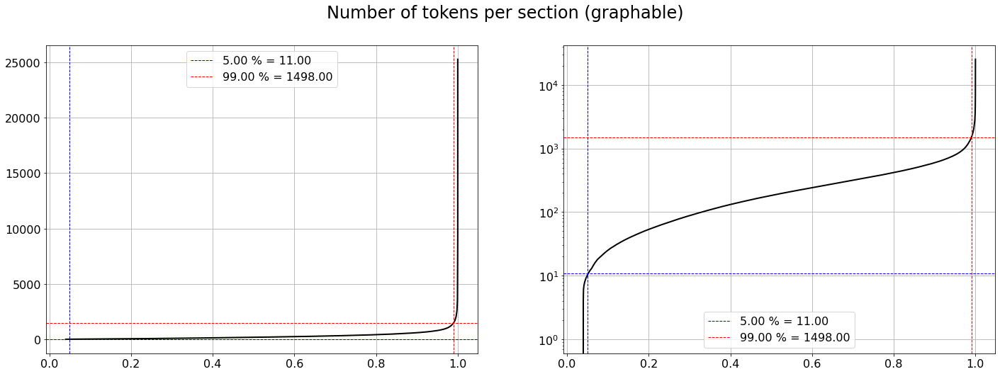

In [17]:
plot_line(section_all_statistics['n_tokens'], [.05, .99], 'Number of tokens per section (all)')
plot_line(section_rep_statistics['n_tokens'], [.05, .99], 'Number of tokens per section (representable)')
plot_line(section_gra_statistics['n_tokens'], [.05, .99], 'Number of tokens per section (graphable)')

In [18]:
MIN_ALL_TOKENS_SECTION, MAX_ALL_TOKENS_SECTION = 16, 3_200
MIN_REP_TOKENS_SECTION, MAX_REP_TOKENS_SECTION = 16, 3_200
MIN_GRA_TOKENS_SECTION, MAX_GRA_TOKENS_SECTION = 10, 1_600

def n_tokens_section_criteria(all_stats: Dict[str, Any], rep_stats: Dict[str, Any], gra_stats: Dict[str, Any]) -> bool:
    return all([MIN_ALL_TOKENS_SECTION <= val <= MAX_ALL_TOKENS_SECTION
               for val in all_stats['tokens_section']] +
              [MIN_REP_TOKENS_SECTION <= val <= MAX_REP_TOKENS_SECTION
               for val in rep_stats['tokens_section']] +
              [MIN_GRA_TOKENS_SECTION <= val <= MAX_GRA_TOKENS_SECTION
               for val in gra_stats['tokens_section']])

## Sentence

We then inspect statistics of sentence in order to filter documents presenting abnormal sentences. The process is very similar to that used at the section level considering only number of tokens.

In [19]:
def get_sentence_statistics(statistics):
    return [sentence for document in statistics.values()
            for section in document['length_sentences_section']
            for sentence in section]

sentence_all_statistics = get_sentence_statistics(all_statistics)
sentence_rep_statistics = get_sentence_statistics(rep_statistics)
sentence_gra_statistics = get_sentence_statistics(gra_statistics)

### Number of tokens

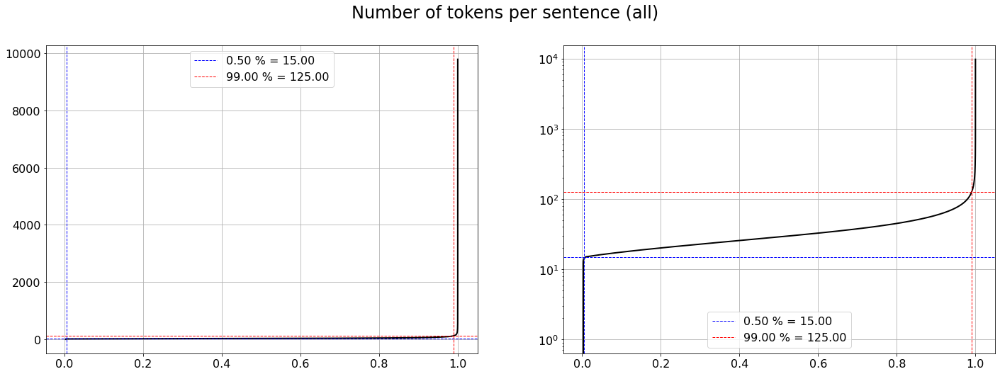

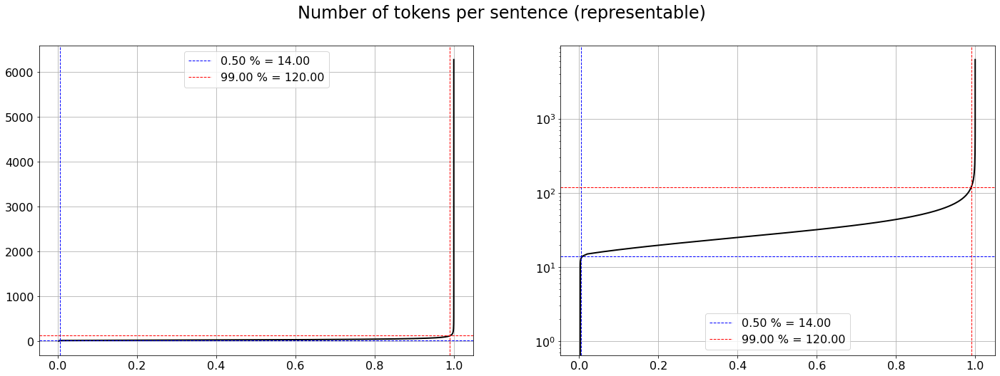

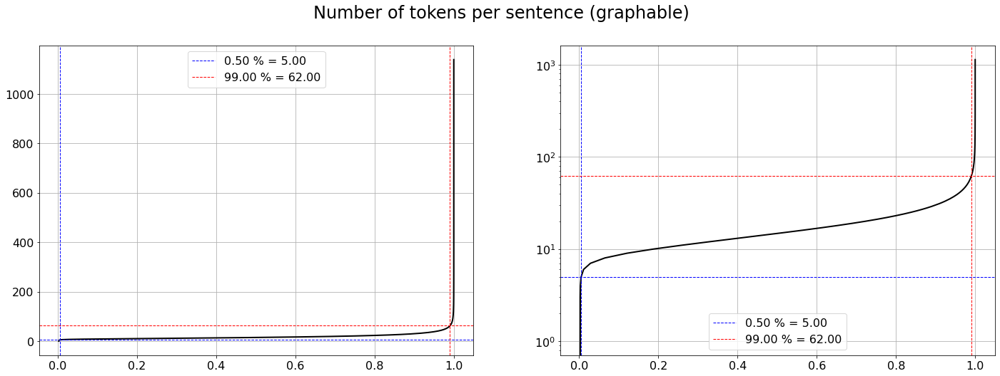

In [23]:
plot_line(sentence_all_statistics, [.005, .99], 'Number of tokens per sentence (all)')
plot_line(sentence_rep_statistics, [.005, .99], 'Number of tokens per sentence (representable)')
plot_line(sentence_gra_statistics, [.005, .99], 'Number of tokens per sentence (graphable)')

In [26]:
MIN_ALL_TOKENS_SENTENCE, MAX_ALL_TOKENS_SENTENCE = 8, 256
MIN_REP_TOKENS_SENTENCE, MAX_REP_TOKENS_SENTENCE = 8, 256
MIN_GRA_TOKENS_SENTENCE, MAX_GRA_TOKENS_SENTENCE = 4, 128

def n_tokens_sentence_criteria(all_stats: Dict[str, Any], rep_stats: Dict[str, Any], gra_stats: Dict[str, Any]) -> bool:
    return all([MIN_ALL_TOKENS_SENTENCE <= length <= MAX_ALL_TOKENS_SENTENCE
               for sentence in all_stats['length_sentences_section'] for length in sentence] +
              [MIN_REP_TOKENS_SENTENCE <= length <= MAX_REP_TOKENS_SENTENCE
               for sentence in rep_stats['length_sentences_section'] for length in sentence] +
              [MIN_GRA_TOKENS_SENTENCE <= length <= MAX_GRA_TOKENS_SENTENCE
               for sentence in gra_stats['length_sentences_section'] for length in sentence])

## Filtering

In [27]:
def criteria_filtering(all_stats, rep_stats, gra_stats, criteria):
    for file in all_stats.keys():
        all_stat, rep_stat, gra_stat = all_stats[file], rep_stats[file], gra_stats[file]
        if all([criterium(all_stat, rep_stat, gra_stat) for criterium in criteria]):
            continue
        retain[file] = False
    
    return retain

criteria = [
    n_sections_criteria, n_sentences_criteria, n_tokens_criteria,
    n_sentences_section_criteria, n_tokens_section_criteria,
    n_tokens_sentence_criteria
]

retain = criteria_filtering(all_statistics, rep_statistics, gra_statistics, criteria)
ret_val = criteria_filtering(all_stats_val, rep_stats_val, gra_stats_val, criteria)

statistics = filter_stats(statistics, retain)
stats_val = filter_stats(stats_val, ret_val)

new_len2, new_len_val2 = len(statistics), len(stats_val)

print('Training')
print_retained(new_len2, old_len)
print('Validation')
print_retained(new_len_val2, old_len_val)

Training
Retained 67.81 % of files (81316/119924)
Validation
Retained 69.32 % of files (4598/6633)


In [28]:
with open('retained.json', 'w') as fp:
    json.dump(list(statistics.keys()), fp)
    fp.flush()
    
with open('retained_val.json', 'w') as fp:
    json.dump(list(stats_val.keys()), fp)
    fp.flush()

# Below not of interest (?)

## Sentences

Finally, we analyze the distribution of the sentences' lengths in terms of tokens to set a truncation bound to the tokenization. 

In [29]:
all_statistics = filter_stats(all_statistics, retain)
rep_statistics = filter_stats(rep_statistics, retain)
gra_statistics = filter_stats(gra_statistics, retain)

In [30]:
def n_tokens_sentence(statistics):
    return [n_tokens for d in statistics.values()
                     for by_section in d['length_sentences_section']
                     for n_tokens in by_section]

all_tokens_sentence = n_tokens_sentence(all_statistics)
rep_tokens_sentence = n_tokens_sentence(rep_statistics)
gra_tokens_sentence = n_tokens_sentence(gra_statistics)

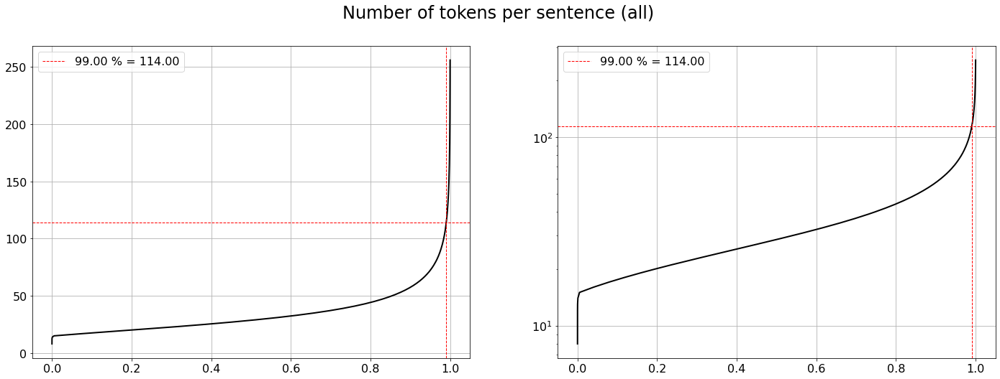

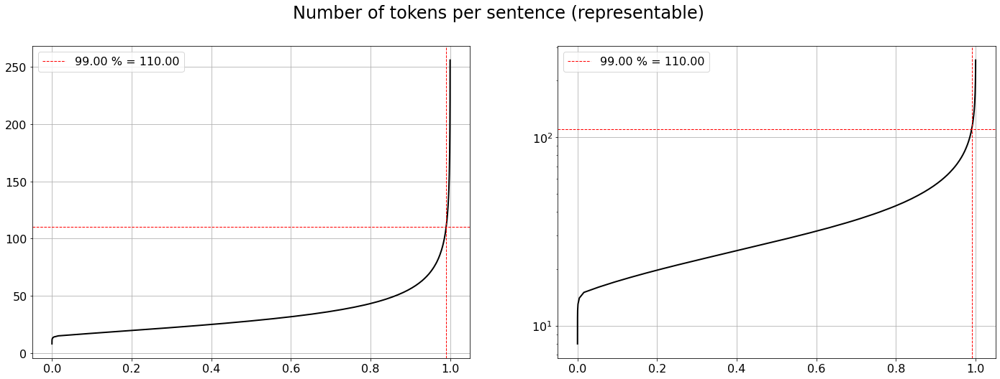

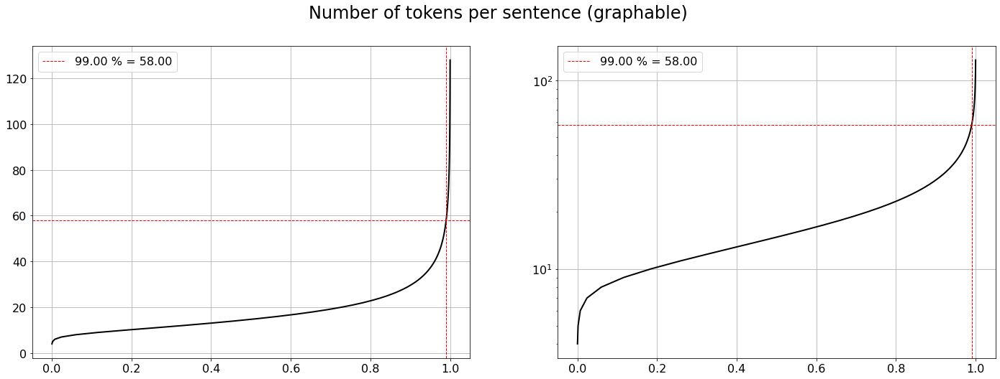

In [31]:
plot_line(all_tokens_sentence, [.99], 'Number of tokens per sentence (all)')
plot_line(rep_tokens_sentence, [.99], 'Number of tokens per sentence (representable)')
plot_line(gra_tokens_sentence, [.99], 'Number of tokens per sentence (graphable)')

# Second inspection

In [1]:
import json
from pprint import pprint
from collections import defaultdict
from dataclasses import dataclass, field
from typing import List

with open("files.stats", 'r') as fp:
    statistics = json.load(fp)

In [8]:
@dataclass
class Sentence:
    n_tokens: int
    in_glove: int
    graphable: int
    is_graphable: bool = field(init=False)
    is_strongly_graphable: bool = field(init=False)
        
    def __post_init__(self):
        self.is_graphable = self.graphable > 0
        self.is_strongly_graphable = self.graphable > 1
        
    def __str__(self):
        output = f"\t\tn_tokens={self.n_tokens}\n"
        output += f"\t\tin_glove={self.n_tokens}\n"
        output += f"\t\tgraphable={self.n_tokens}\n"
        output += f"\t\tis_graphable={self.is_graphable}\n"
        output += f"\t\tis_strongly_graphable={self.is_strongly_graphable}\n"
        return output
    
@dataclass
class Section:
    sentences: List[Sentence]
    n_sentences: int = field(init=False, default=0)
    n_tokens: int = field(init=False, default=0)
    in_glove: int = field(init=False, default=0)
    graphable: int = field(init=False, default=0)
    is_graphable: bool = field(init=False)
    is_strongly_graphable: bool = field(init=False)
    
    def __post_init__(self):
        self.n_sentences = len(self.sentences)
        for sentence in self.sentences:
            self.n_tokens += sentence.n_tokens
            self.in_glove += sentence.in_glove
            self.graphable += sentence.graphable        
        self.is_graphable = all([sentence.is_graphable for sentence in self.sentences])
        self.is_strongly_graphable = all([sentence.is_strongly_graphable for sentence in self.sentences])
        
    def __str__(self):
        output = ""
        for sentence in self.sentences:
            output += f"{sentence}\n"
        output += f"\tn_sentences={self.n_sentences}\n"
        output += f"\tn_tokens={self.n_tokens}\n"
        output += f"\tin_glove={self.in_glove}\n"
        output += f"\tgraphable={self.graphable}\n"
        output += f"\tis_graphable={self.is_graphable}\n"
        output += f"\tis_strongly_graphable={self.is_strongly_graphable}\n"
        return output
    
@dataclass
class Document:
    sections: List[Section]
    n_sections: int = field(init=False, default=0)
    n_sentences: int = field(init=False, default=0)
    n_tokens: int = field(init=False, default=0)
    in_glove: int = field(init=False, default=0)
    graphable: int = field(init=False, default=0)
    is_graphable: bool = field(init=False)
    is_strongly_graphable: bool = field(init=False)
    
    def __post_init__(self):
        self.n_sections = len(self.sections)
        for section in self.sections:
            self.n_sentences += section.n_sentences
            self.n_tokens += section.n_tokens
            self.in_glove += section.in_glove
            self.graphable += section.graphable 
        self.is_graphable = all([section.is_graphable for section in self.sections])
        self.is_strongly_graphable = all([section.is_strongly_graphable for section in self.sections])
        
    def __str__(self):
        output = ""
        for section in self.sections:
            output += f"{section}\n"
        output += f"n_sections={self.is_graphable}\n"
        output += f"n_sentences={self.is_graphable}\n"
        output += f"n_tokens={self.n_tokens}\n"
        output += f"in_glove={self.in_glove}\n"
        output += f"graphable={self.graphable}\n"
        output += f"is_graphable={self.is_graphable}\n"
        output += f"is_strongly_graphable={self.is_strongly_graphable}\n"
        return output

In [9]:
statistics2 = {}
for key, stats in statistics.items():
    statistics2[key] = Document([Section([Sentence(*sentence) for sentence in section])
                               for section in stats])

In [10]:
print(statistics2[list(statistics.keys())[0]])

		n_tokens=24
		in_glove=24
		graphable=24
		is_graphable=True
		is_strongly_graphable=True

		n_tokens=48
		in_glove=48
		graphable=48
		is_graphable=True
		is_strongly_graphable=True

		n_tokens=22
		in_glove=22
		graphable=22
		is_graphable=True
		is_strongly_graphable=True

	n_sentences=3
	n_tokens=94
	in_glove=94
	graphable=52
	is_graphable=True
	is_strongly_graphable=True

		n_tokens=20
		in_glove=20
		graphable=20
		is_graphable=True
		is_strongly_graphable=True

		n_tokens=18
		in_glove=18
		graphable=18
		is_graphable=True
		is_strongly_graphable=True

		n_tokens=33
		in_glove=33
		graphable=33
		is_graphable=True
		is_strongly_graphable=True

		n_tokens=26
		in_glove=26
		graphable=26
		is_graphable=True
		is_strongly_graphable=True

		n_tokens=19
		in_glove=19
		graphable=19
		is_graphable=True
		is_strongly_graphable=True

		n_tokens=38
		in_glove=38
		graphable=38
		is_graphable=True
		is_strongly_graphable=True

		n_tokens=40
		in_glove=40
		graphable=40
		is_graphable=Tr

In [30]:
print(len(statistics))
print(len([doc for doc in statistics.values() if doc.is_graphable]))
print(len([doc for doc in statistics.values() if doc.is_strongly_graphable]))

119924
96642
96554


In [12]:
for key, val in statistics.items():
    pprint(val)
    break

[[[24, 24, 12], [48, 48, 29], [22, 22, 11]],
 [[20, 20, 11],
  [18, 18, 11],
  [33, 33, 16],
  [26, 26, 15],
  [19, 19, 11],
  [38, 38, 19],
  [40, 40, 24],
  [21, 21, 11],
  [30, 30, 16],
  [35, 35, 20],
  [22, 22, 13],
  [38, 37, 22],
  [49, 49, 29],
  [37, 36, 19],
  [26, 26, 15],
  [17, 17, 10],
  [22, 21, 12],
  [36, 35, 21],
  [21, 20, 12],
  [51, 50, 31],
  [34, 34, 17],
  [23, 23, 12],
  [52, 51, 26],
  [40, 40, 24],
  [28, 28, 15],
  [27, 27, 17],
  [17, 17, 11]],
 [[21, 21, 9],
  [16, 16, 8],
  [24, 24, 12],
  [21, 21, 14],
  [48, 47, 27],
  [47, 47, 30],
  [41, 39, 26],
  [21, 21, 11],
  [22, 22, 14],
  [21, 20, 12],
  [44, 43, 27],
  [16, 16, 8],
  [20, 20, 10],
  [56, 55, 29],
  [17, 17, 11],
  [44, 43, 23],
  [42, 42, 23],
  [28, 28, 19]],
 [[23, 22, 11],
  [22, 22, 10],
  [31, 28, 14],
  [17, 17, 10],
  [37, 37, 20],
  [44, 43, 24],
  [35, 35, 17]],
 [[42, 42, 25]],
 [[17, 16, 8], [19, 18, 12]],
 [[29, 29, 16], [38, 38, 19], [44, 44, 21], [19, 18, 10], [31, 30, 18]]]


In [39]:
def get_sentence_statistics(sentence):
    return {'n_tokens': sentence[0], 'in_glove': sentence[1], 'graphble': sentence[2]}

def get_section_statistics(section):
    output = {'n_sentences': len(section)}
    n_tokens = in_glove = non_stop = 0
    for i, sentence in enumerate(section):
        output[f'sentence_{i}'] = get_sentence_statistics(sentence)
    return output

def rename(statistics):
    output = {}
    for key, base in statistics.items():
        output[key] = {'n_sections': len(base)}
        for i, section in enumerate(base):
            output[key][f'section_{i}'] = get_section_statistics(section)
    return output

statistics = rename(statistics)

In [45]:
def print_structure_r(structure, depth=0):
    indent = '\t' * depth
    if isinstance(structure, dict):
        for key, sub in structure.items():
            print(f"{indent}{key}\t({type(sub)})")
            print_structure_r(sub, depth+1)
            
print_structure_r(statistics)

C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC101227.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glov

			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
	

			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_25	(<class 'dict'>)
			n_tokens	(<class '

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_25	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_26	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_27	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_28	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_29	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_30	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_31	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_32	(<class 'd

			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)

			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class '

		sentence_76	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_77	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_78	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_79	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_80	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_81	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_82	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_83	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_84	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class '

		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_25	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)


			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_72	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_73	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_74	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_75	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_76	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_77	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_78	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_79	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_80	(<class 'd

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
		

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
		

		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class '

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_6	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)


			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_38	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_39	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_40	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_41	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_42	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_43	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_44	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_45	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_46	(<class 'd

			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int

		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'

		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)


			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		se

			graphble	(<class 'int'>)
		sentence_35	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_36	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_37	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_38	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_39	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_40	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_41	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_42	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_43	(<class 'dict'>)
			n_tokens	(<class '

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC1224699.txt	(<class 'dict'>)
	n_secti

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_4	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
		

		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
		

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_28	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_29	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_30	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_31	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_32	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_33	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_34	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_35	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)


		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_25	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_26	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_27	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_28	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class '

		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_5	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)


			graphble	(<class 'int'>)
		sentence_91	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_92	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_93	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_94	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_95	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_96	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_97	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_98	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_99	(<class 'dict'>)
			n_tokens	(<class '

		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
		

			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_4	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)


			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
		

			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int

			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)


		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class '

		sentence_25	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_26	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_27	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_28	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_29	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_30	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_31	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_32	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_33	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class '

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_31	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_32	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_33	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_34	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_35	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_36	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_37	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_38	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_2	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dic

			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
		

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
		

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_46	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_47	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_48	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_49	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_50	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_51	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_52	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_53	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'i

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict

			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		

			graphble	(<class 'int'>)
		sentence_25	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
		

	section_2	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)


			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_25	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_26	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_27	(<class 'dict'>)
			n_tokens	(<class '

			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_4	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
		

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
		

			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_2	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_4	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_57	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_58	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_59	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_60	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_61	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_62	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_63	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_64	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_65	(<class 'd

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_30	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_31	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_32	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_33	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_34	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_35	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_36	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_5	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'in

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_29	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_30	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_31	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_32	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_33	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_34	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_35	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_36	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

	section_3	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)


			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_4	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
		

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_7	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)

			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_4	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_5	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_6	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC149422.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence

		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_13	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC150379.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble

			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
		

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_30	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_31	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_32	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_33	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_34	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_35	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_36	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_37	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'in

		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_13	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_14	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>

			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
	

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)

C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC1519548.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC1519560.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC1519561.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC1519563.t

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_4	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'

		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
	

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_2	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
	

			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
		

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_5	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
		

		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC1550790.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_to

		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)

		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_25	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class '

			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_25	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_26	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_27	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_28	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_29	(<class 'dict'>)
			n_tokens	(<class '

			graphble	(<class 'int'>)
		sentence_32	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_33	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_34	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_35	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_36	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_37	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_38	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_39	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_40	(<class 'dict'>)
			n_tokens	(<class '

		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
		

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC156595.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC1567185.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC1567186.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC1567189.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C

		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)


			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	

		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict

		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_25	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_26	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_2	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_3	(<class 'dict'>

		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_25	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_26	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_12	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class '

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)


			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'i

		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_4	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)


			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'

			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC161819.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_token

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
	

		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC1637864.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC1637867.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC1637871.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_12	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
	

			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'i

			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_4	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'd

			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_4	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		

			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		

		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_25	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_26	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class '

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
	

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
		

			graphble	(<class 'int'>)
		sentence_55	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_56	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_57	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_58	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_59	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_60	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_61	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_62	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_63	(<class 'dict'>)
			n_tokens	(<class '

	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_25	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_26	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_27	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_28	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_29	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_30	(<class 'd

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
		

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_2	(<class 'dict'>)
		n_sentences	(<class 'i

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)


			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dic

		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_25	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_26	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class '

			graphble	(<class 'int'>)
		sentence_31	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_32	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_33	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_34	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_35	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_36	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_37	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_38	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_39	(<class 'dict'>)
			n_tokens	(<class '

		sentence_39	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC1802591.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_gl

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'in

		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)

		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'in

		sentence_42	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_2	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_2	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)


			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
		

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_25	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_26	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_27	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_28	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_29	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_30	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_31	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_32	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_35	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_36	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_37	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_38	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_2	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>

			graphble	(<class 'int'>)
		sentence_25	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_26	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_27	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_28	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_29	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_30	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_31	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_32	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_2	(<class 'dict'>)
		n_sentences	(<class 'i

			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC1852886.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			gr

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_27	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_28	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_29	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_30	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_31	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_32	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_33	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_34	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
		

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dic

			graphble	(<class 'int'>)
		sentence_75	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_76	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_77	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_78	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_79	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_80	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_81	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_82	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_83	(<class 'dict'>)
			n_tokens	(<class '

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_34	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_35	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_36	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_37	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_38	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_39	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_40	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_41	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

		sentence_48	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_49	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_50	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_51	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_52	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_53	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_2	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'di

		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_4	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_44	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_45	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_46	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_47	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_48	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_49	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_50	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_51	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_6	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_2	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_25	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_26	(<class 'd

			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_2	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	

			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC1906870.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_toke

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_105	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_106	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_107	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_108	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_109	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_110	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_111	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_2	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<cl

		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_24	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_25	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_26	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_27	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_28	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_29	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_30	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class '

			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'in

			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_23	(<class 'dict'>)
			n_tokens	(<class '

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)


			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_3	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int

			graphble	(<class 'int'>)
		sentence_14	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_15	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_16	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_17	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_18	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_19	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_20	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_21	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_22	(<class 'dict'>)
			n_tokens	(<class '

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_4	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_5	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_6	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
	

			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_2	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>

		sentence_25	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_4	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
C:\Users\giova\Documents\Poli\S3\NLP\Project\pubmed-dataset\parsed\train\PMC1933218.txt	(<class 'dict'>)
	n_sections	(<class 'int'>)
	section_0	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_1	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_2	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_3	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_gl

			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_7	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_8	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_9	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_10	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_11	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_12	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
		sentence_13	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>)
			graphble	(<class 'int'>)
	section_1	(<class 'dict'>)
		n_sentences	(<class 'int'>)
		sentence_0	(<class 'dict'>)
			n_tokens	(<class 'int'>)
			in_glove	(<class 'int'>

KeyboardInterrupt: 

In [ ]:
def graphable(statistics):
    output = []
    for key, stats in statistics.items():
        graphable = True
        for key2, sub 